In [ ]:
#

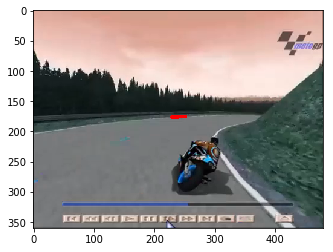

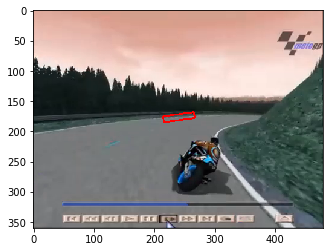

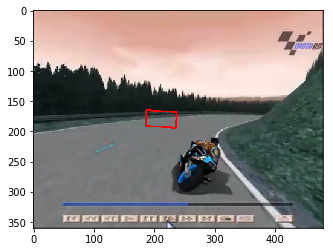

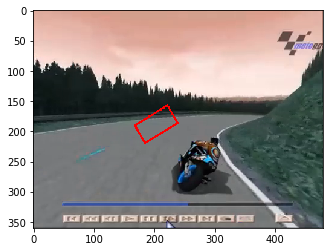

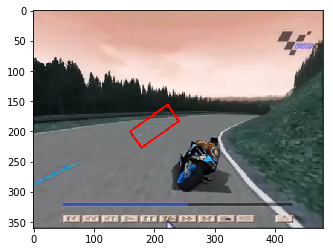

...

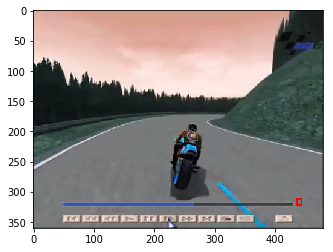

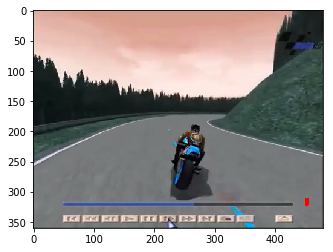

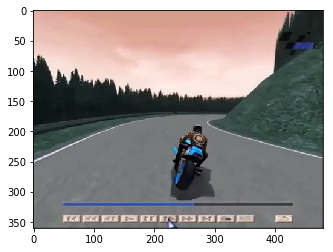

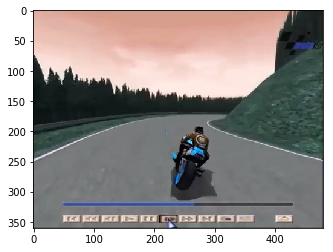

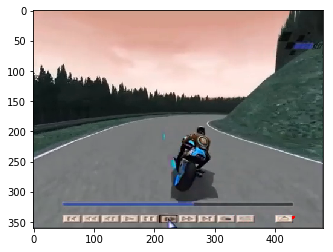

In [ ]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

cap = cv.VideoCapture('img/racevid.mp4')

# take first frame of the video
ret,frame = cap.read()

# setup initial location of window
r,h,c,w = 20,200,-100,5  # simply hardcoded the values
#r,h,c,w = 250,90,400,125

track_window = (c,r,w,h)

# set up the ROI for tracking
roi = frame[r:r+h, c:c+w]
hsv_roi =  cv.cvtColor(roi, cv.COLOR_BGR2HSV)
mask = cv.inRange(hsv_roi, np.array((0., 60.,32.)), np.array((180.,255.,255.)))
roi_hist = cv.calcHist([hsv_roi],[0],mask,[90],[0,90])
cv.normalize(roi_hist,roi_hist,0,255,cv.NORM_MINMAX)

# Setup the termination criteria, either 10 iteration or move by atleast 1 pt
term_crit = ( cv.TERM_CRITERIA_EPS | cv.TERM_CRITERIA_COUNT, 10, 1 )

while(1):
    ret,frame = cap.read()

    if ret == True:
        hsv = cv.cvtColor(frame, cv.COLOR_BGR2HSV)
        dst = cv.calcBackProject([hsv],[0],roi_hist,[0,45],2)

        # apply meanshift to get the new location
        ret, track_window = cv.CamShift(dst, track_window, term_crit)

        # Draw it on image
        pts = cv.boxPoints(ret)
        pts = np.int0(pts)
        img2 = cv.polylines(frame,[pts],True, 255,2)
        
        cv.imshow('img2',img2)
        plt.imshow(img2), plt.show()

        k = cv.waitKey(60) & 0xff
        if k == 27:
            break
        else:
            cv.imwrite(chr(k)+".jpg",img2)

    else:
        break

cv.destroyAllWindows()
cap.release()